Tiingo Python API Github Docs  
https://github.com/hydrosquall/tiingo-python

Main Tiingo Python Docs page  
https://tiingo-python.readthedocs.io/en/latest/

Bokeh Styling Tips  
https://bokeh.github.io/blog/2017/7/24/styling-bokeh/  

In [1]:
from IPython.display import HTML

In [2]:
HTML('''<script>
  function code_toggle() {
    if (code_shown){
      $('div.input').hide('500');
      $('#toggleButton').val('Show Code')
    } else {
      $('div.input').show('500');
      $('#toggleButton').val('Hide Code')
    }
    code_shown = !code_shown
  }

  $( document ).ready(function(){
    code_shown=false;
    $('div.input').hide()
  });
</script>
<form action="javascript:code_toggle()"><input type="submit" id="toggleButton" value="Show Code"></form>''')

In [3]:
import pandas as pd
import time
import pandas_datareader.data as wb
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import scipy
from scipy import stats
from scipy.stats import norm, spearmanr
import datetime

import matplotlib.cbook as cbook
import seaborn as sns
import math as mth
import sklearn

import bokeh
from bokeh.plotting import *
from collections import OrderedDict
from bokeh.io import output_notebook
from bokeh.models import Toggle, BoxAnnotation, CustomJS, HoverTool
output_notebook()

import plotly
import plotly.graph_objs as go
from plotly.graph_objs import *
import plotly.plotly as py
import plotly.tools as tls
import plotly.offline as offline
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import pytz

offline.init_notebook_mode(connected=False)
init_notebook_mode(connected=False)

import cufflinks as cf
import colorlover as cl


#Make all charts public and set a global theme
cf.set_config_file(world_readable=True,theme='white',offline=True)

tls.embed('https://plot.ly/~cufflinks/8')

sns.set_style("white")

%matplotlib inline

from IPython.display import display

from IPython.display import HTML

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

Loading BokehJS ...

Initialize your Tiingo client object  
The below code creates a dictionary that allows you to customize your client object settings if you choose.
Use the below method if you don't have your client object set up in your environment variables in your .bash_profile

In [4]:
from tiingo import TiingoClient

config = {}

config['api_key'] = 'your tiingo api key'

client = TiingoClient(config)

Get metadata for a single ticker

In [5]:
ticker_metadata = client.get_ticker_metadata("NVDA")
ticker_metadata

{'exchangeCode': 'NASDAQ',
 'ticker': 'NVDA',
 'startDate': '1999-01-22',
 'endDate': '2018-12-17',
 'name': 'NVIDIA Corp',
 'description': 'NVIDIA Corporation (NVIDIA) is engaged in creating the graphics chips used in personal computers (PCs). The Company operates in three segments: graphics processing unit (GPU) Business, professional solutions business (PSB) and consumer products business (CPB). Its mobile processors are used in cell phones, tablets and auto infotainment systems. Designers use GPUs to create visual effects in movies and create everything from golf clubs to jumbo jets. NVIDIA solutions are based on two technologies: the GPU and the mobile processor. GPUs are the engines of visual computing, the science and art of using computers to understand, create and enhance images. It has three GPU product brands: GeForce, Quadro and Tesla. During the fiscal year ended January 29, 2012 (fiscal 2012), it acquired Icera Inc. In fiscal 2012, it launched Project Maximus. Effective J

Get the most recent price quote for a ticker

In [6]:
#ticker_price = client.get_ticker_price("NVDA",
#                                  frequency='daily')

In [7]:
# Helper function to pull metadata from the Tiingo API
def ticker_metadata(ticker):
    data = client.get_ticker_metadata(str(ticker))
    #df = pd.DataFrame(data)
    return data

# Helper function to pull historical data from the Tiingo API
def hist_data(symbol,startDate,endDate,frequency):
    data = client.get_ticker_price(ticker=symbol,
                                        startDate=startDate,
                                        endDate=endDate,
                                        frequency=frequency)
    df = pd.DataFrame(data)
    df['date'] = pd.to_datetime(df['date'],infer_datetime_format=True)
    df.index = df['date']
    
    
    df['adjClose Natural Log'] = (df['adjClose'].apply(lambda x: np.log(x)))
    df['adjClose Returns_1'] = (df['adjClose Natural Log'] / df['adjClose Natural Log'].shift())
    
    return df


def cvvp(df,price,volume,n):
    # calculates the Coefficient of Variation of Volume to Price investment factor
    
    #define rolling stdev for price and volume
    rolling_stdev_price = df[price].rolling(window=n,center=False).std()
    rolling_stdev_volume = df[volume].rolling(window=n,center=False).std()
    
    # define moving average for price and volume
    mov_avg_price = df[price].rolling(window=n).mean()
    mov_avg_volume = df[volume].rolling(window=n).mean()
    cvvp = ((rolling_stdev_volume/mov_avg_volume)/(rolling_stdev_price/mov_avg_price))
    # define Coefficient of Variation of Volume to Price metric
    
    return cvvp

# Helper function to pull current quote data from the Tiingo API
def current_quote(ticker, frequency):
    data = client.get_ticker_price(ticker,frequency=frequency)
    df = pd.DataFrame(data)
    
    return df

def difference(dataDf, period):
    return dataDf.sub(dataDf.shift(period), fill_value=0)

def ewm(dataDf, halflife):
    return dataDf.ewm(halflife=halflife, ignore_na=False, min_periods=0, adjust=True).mean()

def ema(df,n):
    EMA = pd.Series(pd.ewma(df['adjClose'], span = n, min_periods = (n-1)).mean())
    return EMA


def rsi(data, period):
    data_upside = data.sub(data.shift(1), fill_value=0)
    data_downside = data_upside.copy()
    data_downside[data_upside > 0] = 0
    data_upside[data_upside < 0] = 0
    
    avg_upside = data_upside.rolling(period).mean()
    avg_downside = -data_downside.rolling(period).mean()
    
    rsi = 100 - (100 * avg_downside / (avg_downside +avg_upside))
    rsi[avg_downside == 0] = 100
    rsi[(avg_downside == 0) & (avg_upside == 0)] = 0
    
    return rsi

def movingaverage(values, window):
    weights = np.repeat(1.0, window)/window
    smas = np.convolve(values, weights, 'valid')
    return smas


def CCI(df,h,l,c,ndays):
    TP = ((df[h] + df[l] + df[c]) / 3)
    CCI = ((TP - TP.rolling(window=ndays).mean()) / (0.015 * TP.rolling(ndays).std()))
    return CCI

def EMA(df,n):
    EMA = pd.Series(pd.ewma(df['adjClose'], span = n, min_periods = (n-1)))
    return EMA


def MOM(df, n):
    M = pd.Series(df['adjClose'].diff(n))
    return M

def ROC(df, n):
    M = df['adjClose'].diff(n - 1)
    N = df['adjClose'].shift(n - 1)
    ROC = pd.Series(M / N)
    return ROC

def nat_log_return(df,price):
    log_return = (np.log(df[price] / df[price].shift()))
    
    return log_return

def buy_sell_volume(df,price,volume):
    log_return = (np.log(df[price] / df[price].shift()))
    buysell_volume = np.where(log_return >= 0,df[volume]*1,df[volume]*-1)
    
    return buysell_volume

def rolling_cumsum(df,data_metric,n):
    roll_cumsum = (df[data_metric].rolling(window=n).sum())
    
    return roll_cumsum

In [11]:
ticker_metadata('GOOGL')

{'description': "Google Inc. (Google) is a global technology company. The Company's business is primarily focused around key areas, such as search, advertising, operating systems and platforms, enterprise and hardware products. The Company generates revenue primarily by delivering online advertising. The Company also generates revenues from Motorola by selling hardware products. The Company provides its products and services in more than 100 languages and in more than 50 countries, regions, and territories. Effective May 16, 2014, Google Inc acquired Quest Visual Inc. Effective May 20, 2014, Google Inc acquired Enterproid Inc, doing business as Divide. In June 2014, Google Inc acquired mDialog Corp. Effective June 25, 2014, Google Inc acquired Appurify Inc, a San Francisco-based developer of mobile bugging application software.",
 'endDate': '2018-03-22',
 'exchangeCode': 'NASDAQ',
 'name': 'Alphabet Inc.("Google") - Class A',
 'startDate': '2004-08-19',
 'ticker': 'GOOGL'}

In [12]:
df_quote = current_quote('GOOGL','daily')
df_quote_w = current_quote('GOOGL','daily')

In [13]:
df_quote
df_quote_w

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,date,divCash,high,low,open,splitFactor,volume
0,1053.15,1083.92,1049.64,1080.01,3418154,1053.15,2018-03-22T00:00:00+00:00,0.0,1083.92,1049.64,1080.01,1.0,3418154


,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,date,divCash,high,low,open,splitFactor,volume
0,1053.15,1083.92,1049.64,1080.01,3418154,1053.15,2018-03-22T00:00:00+00:00,0.0,1083.92,1049.64,1080.01,1.0,3418154


In [8]:
%%time

startDate = '2000-01-01'
endDate = pd.datetime.today()
frequency = 'daily'

df3 = hist_data('MGTI',startDate,endDate,frequency)

Wall time: 332 ms


In [9]:
df3

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,date,divCash,high,low,open,splitFactor,volume,adjClose Natural Log,adjClose Returns_1
date,,,,,,,,,,,,,,,
2017-09-18,2.7000,2.73000,2.4200,2.42500,3702890,2.7000,2017-09-18,0.0,2.73000,2.4200,2.42500,1.0,3702890,0.993252,NaN
2017-09-19,2.5700,2.70000,2.5000,2.59500,1655093,2.5700,2017-09-19,0.0,2.70000,2.5000,2.59500,1.0,1655093,0.943906,0.950319
2017-09-20,2.6400,2.70000,2.5100,2.56500,905334,2.6400,2017-09-20,0.0,2.70000,2.5100,2.56500,1.0,905334,0.970779,1.028470
2017-09-21,2.4100,2.64000,2.3200,2.63500,1563172,2.4100,2017-09-21,0.0,2.64000,2.3200,2.63500,1.0,1563172,0.879627,0.906104
2017-09-22,2.4800,2.49000,2.3100,2.41000,519713,2.4800,2017-09-22,0.0,2.49000,2.3100,2.41000,1.0,519713,0.908259,1.032550
2017-09-25,2.5400,2.62000,2.5000,2.58500,945140,2.5400,2017-09-25,0.0,2.62000,2.5000,2.58500,1.0,945140,0.932164,1.026320
2017-09-26,2.4700,2.59000,2.3500,2.53500,631610,2.4700,2017-09-26,0.0,2.59000,2.3500,2.53500,1.0,631610,0.904218,0.970020
2017-09-27,2.8400,2.86000,2.5150,2.59500,1847633,2.8400,2017-09-27,0.0,2.86000,2.5150,2.59500,1.0,1847633,1.043804,1.154372
2017-09-28,2.8200,2.87000,2.7100,2.85500,834454,2.8200,2017-09-28,0.0,2.87000,2.7100,2.85500,1.0,834454,1.036737,0.993229


In [16]:
startDate = '1980-01-01'
endDate = pd.datetime.today()
frequency = 'daily'

df4 = hist_data('MKL',startDate,endDate,frequency)

In [17]:
df4

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,date,divCash,high,low,open,splitFactor,volume,adjClose Natural Log,adjClose Returns_1
date,,,,,,,,,,,,,,,
1990-03-26,21.75,21.75,21.75,21.75,500,21.75,1990-03-26,0.0,21.75,21.75,21.75,1.0,500,3.079614,NaN
1990-03-27,22.00,22.00,21.75,21.75,300,22.00,1990-03-27,0.0,22.00,21.75,21.75,1.0,300,3.091042,1.003711
1990-03-28,21.75,21.75,21.75,21.75,100,21.75,1990-03-28,0.0,21.75,21.75,21.75,1.0,100,3.079614,0.996303
1990-03-29,21.75,22.50,21.75,22.50,300,21.75,1990-03-29,0.0,22.50,21.75,22.50,1.0,300,3.079614,1.000000
1990-03-30,22.00,22.12,21.75,22.12,14300,22.00,1990-03-30,0.0,22.12,21.75,22.12,1.0,14300,3.091042,1.003711
1990-04-02,22.00,22.50,22.00,22.50,700,22.00,1990-04-02,0.0,22.50,22.00,22.50,1.0,700,3.091042,1.000000
1990-04-03,22.12,22.50,22.00,22.00,2800,22.12,1990-04-03,0.0,22.50,22.00,22.00,1.0,2800,3.096482,1.001760
1990-04-04,22.25,22.50,21.75,22.50,38600,22.25,1990-04-04,0.0,22.50,21.75,22.50,1.0,38600,3.102342,1.001892
1990-04-05,21.75,22.50,21.75,22.25,8500,21.75,1990-04-05,0.0,22.50,21.75,22.25,1.0,8500,3.079614,0.992674


In [19]:
startDate = '2000-01-01'
endDate = pd.datetime.today()

symbol_list = ['NVDA']

for symbol in symbol_list:
    h_ticker_price = client.get_ticker_price(ticker=symbol,
                                        startDate=startDate,
                                        endDate=endDate,
                                        frequency='daily')

In [20]:
h_ticker_price

[{'adjClose': 3.6147430359,
  'adjHigh': 3.6780647469,
  'adjLow': 3.4942773419,
  'adjOpen': 3.6487205393,
  'adjVolume': 7522796,
  'close': 46.81,
  'date': '2000-01-03T00:00:00.000Z',
  'divCash': 0.0,
  'high': 47.63,
  'low': 45.25,
  'open': 47.25,
  'splitFactor': 1.0,
  'volume': 626900},
 {'adjClose': 3.5182160375,
  'adjHigh': 3.5622323488,
  'adjLow': 3.3398341445,
  'adjOpen': 3.5521935409,
  'adjVolume': 7511996,
  'close': 45.56,
  'date': '2000-01-04T00:00:00.000Z',
  'divCash': 0.0,
  'high': 46.13,
  'low': 43.25,
  'open': 46.0,
  'splitFactor': 1.0,
  'volume': 626000},
 {'adjClose': 3.4124224473,
  'adjHigh': 3.4749719422,
  'adjLow': 3.3784449438,
  'adjOpen': 3.4170557432,
  'adjVolume': 4708797,
  'close': 44.19,
  'date': '2000-01-05T00:00:00.000Z',
  'divCash': 0.0,
  'high': 45.0,
  'low': 43.75,
  'open': 44.25,
  'splitFactor': 1.0,
  'volume': 392400},
 {'adjClose': 3.1807576511,
  'adjHigh': 3.4023836394,
  'adjLow': 3.0502531493,
  'adjOpen': 3.402383639

In [21]:
df1 = pd.DataFrame(h_ticker_price)

In [22]:
#df1.head(25)
df1.describe()

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,divCash,high,low,open,splitFactor,volume
count,4584.000000,4584.000000,4584.000000,4584.000000,4.584000e+03,4584.000000,4584.000000,4584.000000,4584.000000,4584.000000,4584.000000,4.584000e+03
mean,25.674737,26.100305,25.211487,25.672650,1.673866e+07,37.591949,0.000507,38.415880,36.728118,37.578909,1.000764,1.123294e+07
std,41.185403,41.725878,40.540035,41.182764,1.178044e+07,41.874165,0.007532,42.641559,41.006215,41.834950,0.026619,8.540036e+06
min,2.276493,2.436496,2.223982,2.254871,9.232320e+05,5.900000,0.000000,6.380000,5.750000,6.000000,1.000000,1.483000e+05
25%,9.032609,9.411765,8.742643,9.079257,9.366674e+06,14.620000,0.000000,14.850000,14.390000,14.635000,1.000000,5.591575e+06
50%,13.532767,13.745445,13.306399,13.512510,1.411255e+07,21.725000,0.000000,22.105000,21.290000,21.790000,1.000000,9.223600e+06
75%,19.967209,20.312943,19.654565,19.967961,2.059225e+07,37.982500,0.000000,38.760000,37.077500,38.025000,1.000000,1.457650e+07
max,250.480000,254.500000,248.480000,251.534187,2.307713e+08,250.480000,0.150000,254.500000,248.480000,251.690000,2.000000,8.733280e+07


In [23]:
df1

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,date,divCash,high,low,open,splitFactor,volume
0,3.614743,3.678065,3.494277,3.648721,7522796,46.81,2000-01-03T00:00:00.000Z,0.00,47.6300,45.2500,47.250,1.0,626900
1,3.518216,3.562232,3.339834,3.552194,7511996,45.56,2000-01-04T00:00:00.000Z,0.00,46.1300,43.2500,46.000,1.0,626000
2,3.412422,3.474972,3.378445,3.417056,4708797,44.19,2000-01-05T00:00:00.000Z,0.00,45.0000,43.7500,44.250,1.0,392400
3,3.180758,3.402384,3.050253,3.402384,3011998,41.19,2000-01-06T00:00:00.000Z,0.00,44.0600,39.5000,44.060,1.0,251000
4,3.234041,3.267246,3.118208,3.166086,1779599,41.88,2000-01-07T00:00:00.000Z,0.00,42.3100,40.3800,41.000,1.0,148300
5,3.339834,3.474972,3.185391,3.243307,5996397,43.25,2000-01-10T00:00:00.000Z,0.00,45.0000,41.2500,42.000,1.0,499700
6,3.204696,3.359140,3.204696,3.320529,3703198,41.50,2000-01-11T00:00:00.000Z,0.00,43.5000,41.5000,43.000,1.0,308600
7,3.122841,3.209330,3.079597,3.204696,3088798,40.44,2000-01-12T00:00:00.000Z,0.00,41.5600,39.8800,41.500,1.0,257400
8,3.253346,3.281918,3.079597,3.118208,3304798,42.13,2000-01-13T00:00:00.000Z,0.00,42.5000,39.8800,40.380,1.0,275400
9,3.393117,3.528255,3.291957,3.301223,15113992,43.94,2000-01-14T00:00:00.000Z,0.00,45.6900,42.6300,42.750,1.0,1259500


In [24]:
type(h_ticker_price)

list

In [20]:
df1.head()

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,date,divCash,high,low,open,splitFactor,volume,adjClose Natural Log,adjClose Returns_1,Natural Log,Lag1,cvvp_30,cvvp_60
date,,,,,,,,,,,,,,,,,,,
2000-01-03,16.277607,16.759281,15.952353,16.697209,7384400,65.56,2000-01-03,0.0,67.50,64.25,67.25,1.0,1846100,2.789790,NaN,2.789790,NaN,NaN,NaN
2000-01-04,14.912036,16.339678,14.882241,15.641995,7813200,60.06,2000-01-04,0.0,65.81,59.94,63.00,1.0,1953300,2.702169,0.968592,2.702169,0.968592,NaN,NaN
2000-01-05,15.177701,15.579924,14.462639,14.462639,14927200,61.13,2000-01-05,0.0,62.75,58.25,58.25,1.0,3731800,2.719827,1.006535,2.719827,1.006535,NaN,NaN
2000-01-06,15.331638,15.550130,15.053559,15.254670,10221200,61.75,2000-01-06,0.0,62.63,60.63,61.44,1.0,2555300,2.729919,1.003710,2.729919,1.003710,NaN,NaN
2000-01-07,16.076495,16.076495,15.115630,15.284464,8253200,64.75,2000-01-07,0.0,64.75,60.88,61.56,1.0,2063300,2.777358,1.017378,2.777358,1.017378,NaN,NaN


In [66]:
df1.tail()

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,date,divCash,high,low,open,splitFactor,volume,adjClose Natural Log,adjClose Returns_1,Natural Log,Lag1,cvvp,cvvp_30,cvvp_60
date,,,,,,,,,,,,,,,,,,,,
2018-12-11,245.34,251.75,242.7845,251.43,3179388,245.34,2018-12-11,0.0,251.75,242.7845,251.43,1.0,3179388,5.502645,1.000929,5.502645,1.000929,8.458600,8.458600,6.549948
2018-12-12,245.55,251.56,245.0400,249.99,4067868,245.55,2018-12-12,0.0,251.56,245.0400,249.99,1.0,4067868,5.503501,1.000155,5.503501,1.000155,8.416538,8.416538,6.598245
2018-12-13,248.08,251.60,245.2000,248.15,5395115,248.08,2018-12-13,0.0,251.60,245.2000,248.15,1.0,5395115,5.513751,1.001863,5.513751,1.001863,8.297573,8.297573,6.670847
2018-12-14,230.00,240.92,229.9100,240.76,12189411,230.00,2018-12-14,0.0,240.92,229.9100,240.76,1.0,12189411,5.438079,0.986276,5.438079,0.986276,11.874395,11.874395,7.890752
2018-12-17,221.38,230.63,220.4800,226.93,7059515,221.38,2018-12-17,0.0,230.63,220.4800,226.93,1.0,7059515,5.399881,0.992976,5.399881,0.992976,11.168705,11.168705,7.711616


In [70]:
#df1['cvvp'].plot()
#df1['adjClose Returns_1'].plot(secondary_y=True)

df1.corr()

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,divCash,high,low,open,splitFactor,volume,adjClose Natural Log,adjClose Returns_1,Natural Log,Lag1,cvvp,cvvp_30,cvvp_60
adjClose,1.000000,0.999843,0.999878,0.999695,-0.337782,0.934337,-0.037932,0.930956,0.938010,0.934380,-0.008306,-0.202512,0.916067,0.009879,0.916067,0.009879,0.201133,0.201133,0.227444
adjHigh,0.999843,1.000000,0.999786,0.999882,-0.334027,0.935019,-0.037669,0.932024,0.938759,0.935471,-0.007996,-0.199791,0.914790,0.003960,0.914790,0.003960,0.198748,0.198748,0.224444
adjLow,0.999878,0.999786,1.000000,0.999827,-0.341076,0.933184,-0.038502,0.929871,0.937183,0.933549,-0.008521,-0.204597,0.916897,0.004479,0.916897,0.004479,0.203640,0.203640,0.229814
adjOpen,0.999695,0.999882,0.999827,1.000000,-0.337113,0.933931,-0.038113,0.930959,0.937923,0.934717,-0.008594,-0.201828,0.915535,-0.001340,0.915535,-0.001340,0.201029,0.201029,0.226689
adjVolume,-0.337782,-0.334027,-0.341076,-0.337113,1.000000,-0.273134,0.038415,-0.266439,-0.280159,-0.272807,-0.012376,0.849177,-0.415447,-0.073369,-0.415447,-0.073369,-0.233106,-0.233106,-0.259872
close,0.934337,0.935019,0.933184,0.933931,-0.273134,1.000000,-0.000731,0.999689,0.999689,0.999412,-0.005175,-0.280110,0.822759,0.021579,0.822759,0.021579,0.098800,0.098800,0.128337
divCash,-0.037932,-0.037669,-0.038502,-0.038113,0.038415,-0.000731,1.000000,-0.000177,-0.002969,-0.002218,-0.001302,-0.017257,-0.055416,0.006927,-0.055416,0.006927,-0.027533,-0.027533,-0.038158
high,0.930956,0.932024,0.929871,0.930959,-0.266439,0.999689,-0.000177,1.000000,0.999441,0.999715,-0.004485,-0.277465,0.818024,0.011124,0.818024,0.011124,0.093842,0.093842,0.122777
low,0.938010,0.938759,0.937183,0.937923,-0.280159,0.999689,-0.002969,0.999441,1.000000,0.999648,-0.005465,-0.282054,0.827449,0.011424,0.827449,0.011424,0.104186,0.104186,0.133358
open,0.934380,0.935471,0.933549,0.934717,-0.272807,0.999412,-0.002218,0.999715,0.999648,1.000000,-0.005578,-0.279299,0.822418,0.001234,0.822418,0.001234,0.098879,0.098879,0.127606


In [67]:
df1.describe()

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,divCash,high,low,open,splitFactor,volume,adjClose Natural Log,adjClose Returns_1,Natural Log,Lag1,cvvp,cvvp_30,cvvp_60
count,4770.000000,4770.000000,4770.000000,4770.000000,4.770000e+03,4770.000000,4770.000000,4770.000000,4770.000000,4770.000000,4770.000000,4.770000e+03,4770.000000,4769.000000,4770.000000,4769.000000,4741.000000,4741.000000,4711.000000
mean,54.469959,55.127705,53.749584,54.452319,5.817333e+06,63.017396,0.000063,63.892790,62.057972,62.989600,1.000419,4.641596e+06,3.692935,1.000178,3.692935,1.000178,13.507331,13.507331,10.791144
std,52.999181,53.525696,52.425003,53.014639,4.428617e+06,51.686535,0.000989,52.301496,51.001664,51.684863,0.020474,3.780198e+06,0.721755,0.008829,0.721755,0.008829,7.935187,7.935187,5.881760
min,8.319143,8.717665,8.219512,8.498478,8.749900e+04,15.980000,0.000000,16.480000,15.700000,15.730000,1.000000,8.749900e+04,2.118559,0.857545,2.118559,0.857545,1.772320,1.772320,1.340407
25%,26.189102,26.842500,25.660000,26.247172,3.124990e+06,32.672500,0.000000,33.126250,32.222500,32.685000,1.000000,2.504100e+06,3.265343,0.997002,3.265343,0.997002,7.607272,7.607272,6.317716
50%,33.860000,34.260000,33.372500,33.790000,4.963900e+06,40.750000,0.000000,41.370000,40.060000,40.780000,1.000000,3.688050e+06,3.522234,1.000180,3.522234,1.000180,12.188445,12.188445,9.601055
75%,62.875000,63.457500,61.558750,62.905000,7.147550e+06,73.025000,0.000000,73.777500,72.257500,73.017500,1.000000,5.660825e+06,4.141149,1.003327,4.141149,1.003327,17.613240,17.613240,14.332239
max,275.490000,277.610000,271.850000,275.000000,1.087524e+08,275.490000,0.025000,277.610000,271.850000,275.000000,2.000000,1.087524e+08,5.618551,1.068365,5.618551,1.068365,95.010799,95.010799,36.527974


In [28]:
df_avail_data = pd.DataFrame(client.list_stock_tickers())

In [29]:
df_avail_data

,ticker,exchange,assetType,priceCurrency,startDate,endDate
0,000001,SHE,Stock,CNY,2007-08-30,2018-03-22
1,000002,SHE,Stock,CNY,2000-01-04,2018-03-22
2,000004,SHE,Stock,CNY,2007-08-31,2018-03-22
3,000005,SHE,Stock,CNY,2001-01-02,2018-03-22
4,000006,SHE,Stock,CNY,2007-08-31,2018-03-22
5,000007,SHE,Stock,CNY,2007-08-31,2018-03-22
6,000008,SHE,Stock,CNY,2000-01-03,2018-03-22
7,000009,SHE,Stock,CNY,2000-01-03,2018-03-22
8,000010,SHE,Stock,CNY,2007-08-31,2018-03-22
9,000011,SHE,Stock,CNY,2018-01-02,2018-03-22


In [8]:
%%time

startDate = '2000-01-01'
endDate = pd.datetime.today()
frequency = 'daily'

df1 = hist_data('IBUY',startDate,endDate,frequency)

Wall time: 370 ms


In [9]:
#df1 = pd.DataFrame(h_ticker_price)
#df1 = df4
df1['date'] = pd.to_datetime(df1['date'],infer_datetime_format=True);
df1.index = df1['date']

df1['Natural Log'] = (df1['adjClose'].apply(lambda x: np.log(x)))
df1['Lag1'] = (df1['Natural Log'] / df1['Natural Log'].shift())

df1['cvvp_30'] = cvvp(df1,'adjClose','adjVolume',30)
df1['cvvp_60'] = cvvp(df1,'adjClose','adjVolume',60)

df1['buy_sell_volume'] = buy_sell_volume(df1,'adjClose','adjVolume')

df1['cumsum_30'] = rolling_cumsum(df1,'buy_sell_volume',30)

In [10]:
df1.dropna(how='any',axis=0,inplace=True)

In [11]:
from bokeh.models import ColumnDataSource

TOOLS="crosshair,pan,wheel_zoom,box_zoom,reset,undo,redo,tap,previewsave,box_select,poly_select,lasso_select,hover"

hist, edges = np.histogram(df1['cvvp_30'],density=True,bins=50)
hist1, edges1 = np.histogram(df1['cvvp_60'],density=True,bins=50)


data_df = pd.DataFrame({'cvvp_30':hist,
                        'cvvp_60':hist1,
                       'left':edges[:-1],
                       'right':edges[1:]})

p = figure(tools=TOOLS,
           plot_height=400,
           plot_width=650,
          title='cvvp_30 vs cvvp_60',
          background_fill_color='#fafafa')

p.quad(bottom=0,top=data_df['cvvp_30'],
      left=data_df['left'],right=data_df['right'],
      fill_color='blue',line_color='black',
      alpha=0.5,legend='cvvp_30')

p.quad(bottom=0,top=data_df['cvvp_60'],
      left=data_df['left'],right=data_df['right'],
      fill_color='orange',line_color='black',
      alpha=0.5,legend='cvvp_60')

p.grid.grid_line_color='white'

show(p);

In [23]:
TOOLS="reset,crosshair,pan,wheel_zoom,box_zoom,undo,redo,tap,previewsave,box_select,poly_select,lasso_select,hover"
f = figure(tools=TOOLS,
           x_axis_type= 'datetime',
           plot_height=500,
           plot_width=950)

f.circle(x=df1['date'],
        y=df1['adjClose'],
        size=(df1['adjVolume']/1500000),color='orange',
         alpha=0.5,line_color='black',line_width=1)
# Need to include the ; after we call show(f). This tells JupyterNB to omit printing the glyph renderer message to the notebook
show(f);

In [24]:
TOOLS="reset,crosshair,pan,wheel_zoom,box_zoom,undo,redo,tap,previewsave,box_select,poly_select,lasso_select,hover"
f = figure(tools=TOOLS,
           x_axis_type= 'datetime',
           plot_height=500,
           plot_width=950)

f.circle(x=df1['date'],
        y=df1['adjClose'],
        size=(df1['cvvp_30']/2),color='orange',
         alpha=0.5,line_color='black',line_width=1)

# Need to include the ; after we call show(f). This tells JupyterNB to omit printing the glyph renderer message to the notebook
show(f);

In [17]:
TOOLS="reset,crosshair,pan,wheel_zoom,box_zoom,undo,redo,tap,previewsave,box_select,poly_select,lasso_select,hover"
f = figure(tools=TOOLS,
           x_axis_type= 'datetime',
           plot_height=500,
           plot_width=950)

f.circle(x=df1['date'],
        y=df1['buy_sell_volume'],
        size=(df1['adjVolume']),color='orange',
         alpha=0.5,line_color='black',line_width=1)

# Need to include the ; after we call show(f). This tells JupyterNB to omit printing the glyph renderer message to the notebook
show(f);

In [16]:
TOOLS="reset,crosshair,pan,wheel_zoom,box_zoom,undo,redo,tap,previewsave,box_select,poly_select,lasso_select,hover"
f = figure(tools=TOOLS,
           x_axis_type= 'datetime',
           plot_height=400,
           plot_width=650)

f.line(x=df1['date'],
        y=df1['cumsum_30'],
         color='orange',
         alpha=0.5,
         line_color='black',line_width=1)

# Need to include the ; after we call show(f). This tells JupyterNB to omit printing the glyph renderer message to the notebook
show(f);

In [10]:
TOOLS="resize,crosshair,pan,wheel_zoom,box_zoom,reset,undo,redo,tap,previewsave,box_select,poly_select,lasso_select,hover"
f = figure(tools=TOOLS,
           x_axis_type= 'datetime',
           plot_height=500,
           plot_width=950)

f.circle(x=df1['date'],
        y=df1['adjClose'],
        size=(df1['adjVolume']/100000))
# Need to include the ; after we call show(f). This tells JupyterNB to omit printing the glyph renderer message to the notebook
show(f);

In [11]:
startDate = '1900-01-01'
endDate = pd.datetime.today()
frequency = 'daily'
symbol = 'CANN'

df1 = hist_data(symbol,startDate,endDate,frequency)

TOOLS="resize,crosshair,pan,wheel_zoom,box_zoom,reset,undo,redo,tap,previewsave,box_select,poly_select,lasso_select,hover"
f = figure(tools=TOOLS,
           x_axis_type= 'datetime',
           plot_height=500,
           plot_width=950,
          title=symbol)

f.circle(x=df1['date'],
        y=df1['adjClose'],
        size=(df1['adjVolume']/100000))
# Need to include the ; after we call show(f). This tells JupyterNB to omit printing the glyph renderer message to the notebook
show(f);

In [12]:
startDate = '1900-01-01'
endDate = pd.datetime.today()
frequency = 'daily'
symbol = 'PRRE'

df1 = hist_data(symbol,startDate,endDate,frequency)

TOOLS="resize,crosshair,pan,wheel_zoom,box_zoom,reset,undo,redo,tap,previewsave,box_select,poly_select,lasso_select,hover"
f = figure(tools=TOOLS,
           x_axis_type= 'datetime',
           plot_height=500,
           plot_width=950,
          title=symbol)

f.circle(x=df1['date'],
        y=df1['adjClose'],
        size=(df1['adjVolume']/100000))
# Need to include the ; after we call show(f). This tells JupyterNB to omit printing the glyph renderer message to the notebook
show(f);

In [109]:
startDate = '1900-01-01'
endDate = pd.datetime.today()
frequency = 'daily'
symbol = 'AAMBX'

df1 = hist_data(symbol,startDate,endDate,frequency)

TOOLS="crosshair,pan,wheel_zoom,box_zoom,reset,undo,redo,tap,previewsave,box_select,poly_select,lasso_select,hover"
f = figure(tools=TOOLS,
           x_axis_type= 'datetime',
           plot_height=500,
           plot_width=950,
          title=symbol)

f.circle(x=df1['date'],
        y=df1['adjClose'],
        size=(df1['adjVolume']))
# Need to include the ; after we call show(f). This tells JupyterNB to omit printing the glyph renderer message to the notebook
show(f);

In [19]:
df1.head()

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,date,divCash,high,low,open,splitFactor,volume,adjClose Natural Log,adjClose Returns_1
date,,,,,,,,,,,,,,,
1976-10-29,3.460409,3.460409,3.460409,3.460409,0.0,12.70000,1976-10-29,0.0,12.70000,12.70000,12.70000,1.0,0.0,1.241387,NaN
1976-11-30,3.460409,3.460409,3.460409,3.460409,0.0,12.70000,1976-11-30,0.0,12.70000,12.70000,12.70000,1.0,0.0,1.241387,1.000000
1976-12-03,3.457022,3.457022,3.457022,3.457022,0.0,12.68757,1976-12-03,0.0,12.68757,12.68757,12.68757,1.0,0.0,1.240407,0.999211
1976-12-31,3.498473,3.498473,3.498473,3.498473,0.0,12.83970,1976-12-31,0.0,12.83970,12.83970,12.83970,1.0,0.0,1.252327,1.009609
1977-01-31,3.488092,3.488092,3.488092,3.488092,0.0,12.80160,1977-01-31,0.0,12.80160,12.80160,12.80160,1.0,0.0,1.249355,0.997627


In [11]:
startDate = '1900-01-01'
endDate = pd.datetime.today()
frequency = 'daily'
symbol = 'ADX'

df1 = hist_data(symbol,startDate,endDate,frequency)

TOOLS="resize,crosshair,pan,wheel_zoom,box_zoom,reset,undo,redo,tap,previewsave,box_select,poly_select,lasso_select,hover"
f = figure(tools=TOOLS,
           x_axis_type= 'datetime',
           plot_height=500,
           plot_width=950,
          title=symbol)

f.circle(x=df1['date'],
        y=df1['adjClose'],
        size=(df1['adjVolume']))
# Need to include the ; after we call show(f). This tells JupyterNB to omit printing the glyph renderer message to the notebook
show(f);

In [14]:
%%time

startDate = '1900-01-01'
endDate = pd.datetime.today()
frequency = 'daily'
symbol = 'JNJ'

df1 = hist_data(symbol,startDate,endDate,frequency)

Wall time: 4.01 s


In [20]:
df1.head()

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,date,divCash,high,low,open,splitFactor,volume,adjClose Natural Log,adjClose Returns_1
date,,,,,,,,,,,,,,,
1970-01-02,0.451422,0.464283,0.451422,0.462997,1195200,175.50,1970-01-02,0.0,180.5,175.50,180.00,1.0,8300,-0.795353,NaN
1970-01-05,0.440490,0.452708,0.439847,0.451422,964800,171.25,1970-01-05,0.0,176.0,171.00,175.50,1.0,6700,-0.819868,1.030822
1970-01-06,0.448850,0.448850,0.438561,0.440490,1036800,174.50,1970-01-06,0.0,174.5,170.50,171.25,1.0,7200,-0.801067,0.977069
1970-01-07,0.446920,0.450136,0.445634,0.448850,331200,173.75,1970-01-07,0.0,175.0,173.25,174.50,1.0,2300,-0.805375,1.005377
1970-01-08,0.450136,0.453994,0.446920,0.446920,460800,175.00,1970-01-08,0.0,176.5,173.75,173.75,1.0,3200,-0.798206,0.991099


In [19]:
df1.describe()

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,divCash,high,low,open,splitFactor,volume,adjClose Natural Log,adjClose Returns_1
count,12112.000000,12112.000000,12112.000000,12112.000000,1.211200e+04,12112.000000,12112.000000,12112.000000,12112.000000,12112.000000,12112.000000,1.211200e+04,12112.000000,12111.000000
mean,25.174167,25.348506,24.984569,25.167560,6.168330e+06,73.955997,0.005719,74.563520,73.306735,73.937207,1.000661,3.804376e+06,1.977885,1.133099
std,31.758207,31.933307,31.566921,31.749310,5.053566e+06,24.429332,0.050534,24.566238,24.288542,24.433061,0.031471,5.137291e+06,1.852665,30.515207
min,0.288993,0.305383,0.287988,0.297652,8.640000e+04,28.250000,0.000000,28.750000,28.000000,28.120000,1.000000,1.500000e+03,-1.241352,-432.769259
25%,0.982521,0.993132,0.975936,0.982528,2.844850e+06,56.300000,0.000000,56.880000,55.700000,56.250000,1.000000,1.518000e+05,-0.017633,0.995796
50%,6.883424,6.948229,6.795534,6.866029,5.312506e+06,68.735000,0.000000,69.250000,68.175000,68.680000,1.000000,1.069300e+06,1.929116,1.000000
75%,43.175797,43.519308,42.818678,43.153839,8.330526e+06,90.630000,0.000000,91.500000,89.955000,90.630000,1.000000,6.697775e+06,3.765280,1.004663
max,142.890000,143.800000,142.210000,143.600000,1.446720e+08,177.250000,0.840000,180.500000,176.750000,180.000000,3.000000,9.844020e+07,4.962075,3268.932154


In [58]:
def EMA(df,n):
    EMA = pd.Series(pd.ewma(df['adjClose'], span = n, min_periods = (n-1)))
    return EMA


def MOM(df, n):
    M = pd.Series(df['adjClose'].diff(n))
    return M

def ROC(df, n):
    M = df['adjClose'].diff(n - 1)
    N = df['adjClose'].shift(n - 1)
    ROC = pd.Series(M / N)
    return ROC


# Need to figure out the correct formula for this so that you know the correct references 
'''
def ATR(df, n):
    i = 0
    TR_l = [0]
    
    while i < len(df):
        TR = (df['adjHigh'].shift(1), df['adjClose']) - min(df['adjLow'].shift(1), df['adjClose']))
        TR_l.append(TR)
        i = i + 1
    TR_s = pd.Series(TR_l)
    ATR = pd.Series(pd.ewma(TR_s, span = n, min_period = n))
    return ATR
'''

df1['EMA_50'] = EMA(df1,50)
df1['MOM_14'] = MOM(df1,14)
df1['ROC_30'] = ROC(df1,30)
df1['ATR_14'] = ATR(df1,14)

"\ndef ATR(df, n):\n    i = 0\n    TR_l = [0]\n    \n    while i < len(df):\n        TR = (df['adjHigh'].shift(1), df['adjClose']) - min(df['adjLow'].shift(1), df['adjClose']))\n        TR_l.append(TR)\n        i = i + 1\n    TR_s = pd.Series(TR_l)\n    ATR = pd.Series(pd.ewma(TR_s, span = n, min_period = n))\n    return ATR\n"

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\__main__.py:2: FutureWarning:

pd.ewm_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.ewm(span=50,min_periods=49,adjust=True,ignore_na=False).mean()



ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

In [50]:
df1.tail()

,adjClose,adjHigh,adjLow,adjOpen,adjVolume,close,date,divCash,high,low,open,splitFactor,volume,adjClose Natural Log,adjClose Returns_1,EMA_50,MOM_14,ROC_30
date,,,,,,,,,,,,,,,,,,
2017-12-29,139.72,141.2074,139.580,140.98,4419945,139.72,2017-12-29,0.0,141.2074,139.580,140.98,1.0,4419945,4.939640,0.998788,139.143516,-0.87,0.012241
2018-01-02,139.23,139.9500,138.720,139.66,6835739,139.23,2018-01-02,0.0,139.9500,138.720,139.66,1.0,6835739,4.936127,0.999289,139.146907,-1.91,0.015050
2018-01-03,140.56,140.6800,138.900,139.36,5241755,140.56,2018-01-03,0.0,140.6800,138.900,139.36,1.0,5241755,4.945634,1.001926,139.202322,-2.04,0.025266
2018-01-04,140.55,141.1400,140.220,140.45,4777518,140.55,2018-01-04,0.0,141.1400,140.220,140.45,1.0,4777518,4.945563,0.999986,139.255173,-2.34,0.022155
2018-01-05,141.71,141.8200,140.281,140.69,5900718,141.71,2018-01-05,0.0,141.8200,140.281,140.69,1.0,5900718,4.953783,1.001662,139.351440,0.06,0.038473


In [52]:
while i < df1.index[-1]:
    df1.get_values(i + 1, 'adjHigh')

NameError: name 'i' is not defined

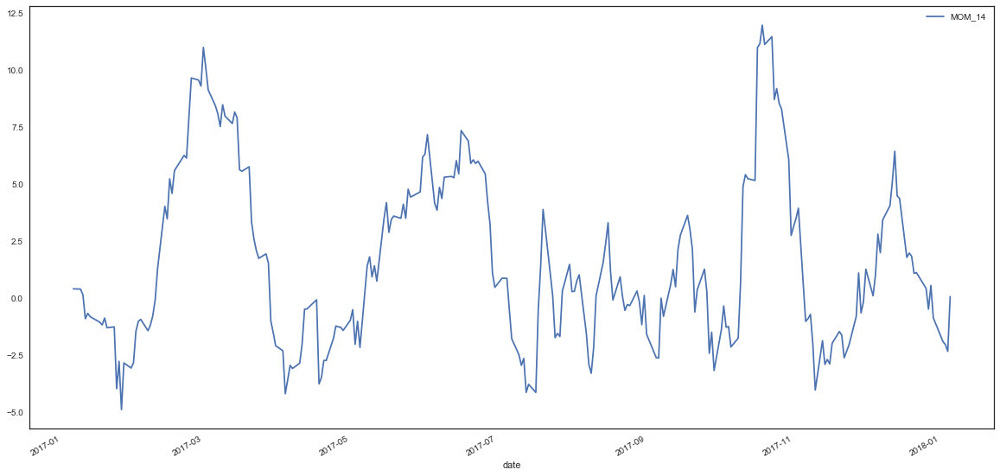

In [47]:
f, ax = plt.subplots(figsize=(20,10))

#df1['EMA_50'].iloc[-252:].plot(legend=True,ax=ax)
#df1['adjClose'].iloc[-252:].plot(legend=True,ax=ax)
df1['MOM_14'].iloc[-252:].plot(legend=True,ax=ax)


In [27]:
from statsmodels.tsa.stattools import acf
from statsmodels.tsa.stattools import pacf

f = figure(tools=TOOLS,
           plot_height=500,
           plot_width=950,
          title='NVDA')

f.line(x=df1['date'].iloc[1:],
       y=acf(df1['Lag1'].iloc[1:]),
      line_width=3,
      alpha=0.7)

show(f);

ImportError: cannot import name 'TimeSeries'

In [110]:
f = figure(tools=TOOLS,
           plot_height=500,
           plot_width=950,
          title='NVDA')

f.line(x=df1['date'].iloc[1:],
       y=pacf(df1['Lag1'].iloc[1:]),
      line_width=3,
      alpha=0.7)

show(f);

C:\ProgramData\Anaconda3\lib\site-packages\bokeh\models\sources.py:81: BokehUserWarning:

ColumnDataSource's columns must be of the same length

